In [1]:
# open the generated synthetic data file and read it as a python dictionary called data

import json

file = open('synthetic_dataset_with_time.txt', 'r')
text = file.read()
data = json.loads(text)


In [2]:
import emip_toolkit as EMTK

# find areas of interest (AOIs) once again
image_path = "./"
image = "synthetic_text.png"
aoi = EMTK.find_aoi(image, image_path, level="sub-line")


# add tokens to AOIs 
file_path = "./"
aois_with_tokens = EMTK.add_tokens_to_AOIs(file_path, image.split(".")[0]+".txt", aoi)
aois_with_tokens.head()


import correction

# find the y coordinate of each line in the text
line_ys = correction.find_lines_Y(aoi)

In [3]:
import numpy as np
import drift_algorithms as algo
from tqdm import tqdm

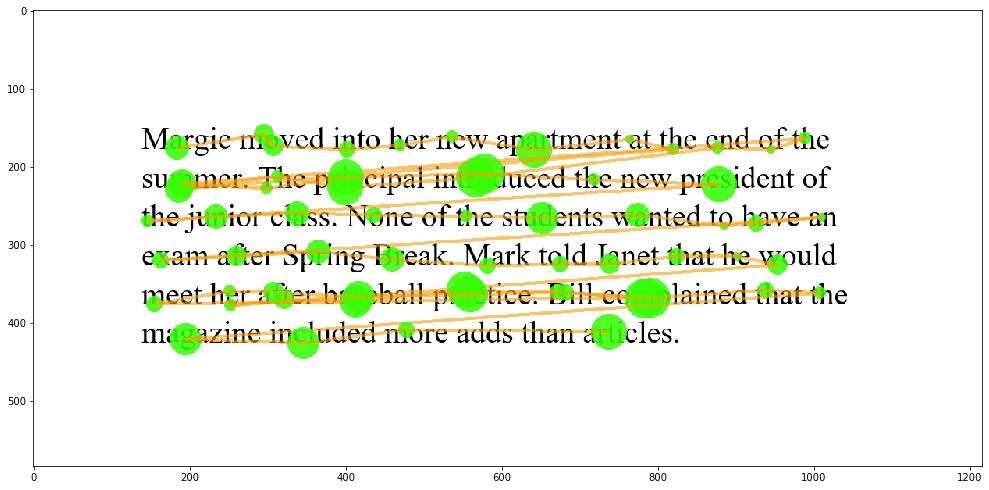

In [4]:
# draw original correct fixations

correction.draw_fixation('synthetic_text.png', data['robot1'].copy())

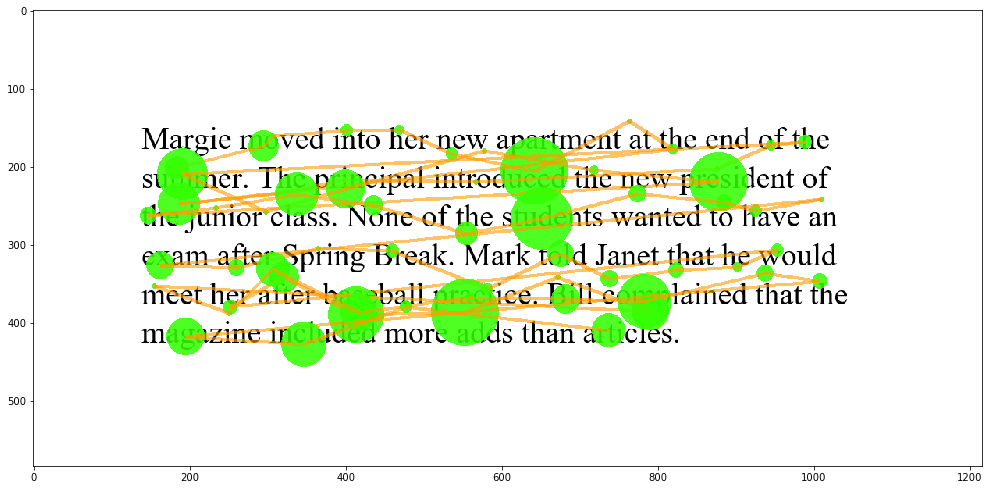

In [5]:
# generate noise over the correct trial

error_test = correction.error_noise(1, 30, 1, data['robot1'].copy())

# draw the trial with added error
correction.draw_fixation('synthetic_text.png', error_test)

0.9344262295081968


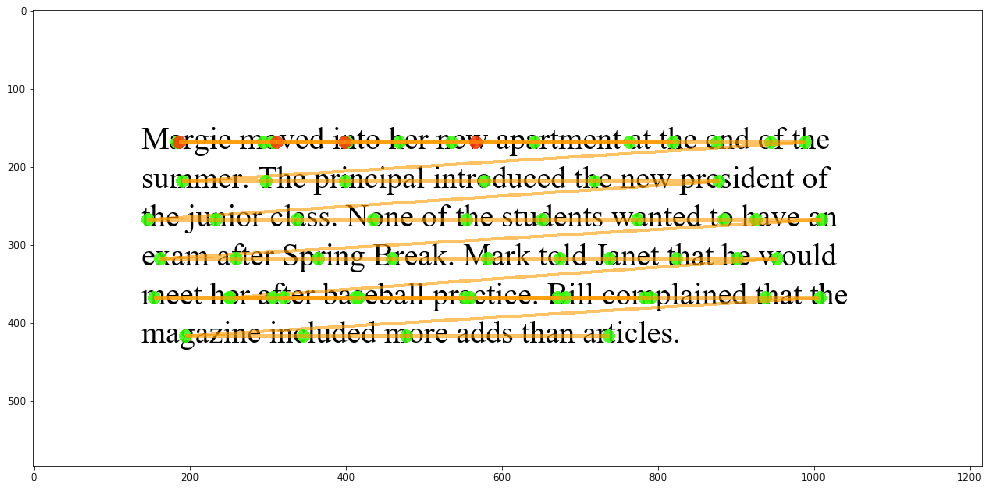

In [6]:
# find the center of each word, we need this for warp algorithm
word_centers = correction.find_word_centers(aoi)
word_centers = np.array(word_centers.copy(), dtype=int)

# warp correction
np_array = np.array(error_test.copy(), dtype=int)
durations = np.delete(np_array, 0, 1)
durations = np.delete(durations, 0, 1)
np_array = np.delete(np_array, 2, 1)

# run warp
warp_correction = algo.warp(np_array, word_centers)

# this is a cool function that checks the quality of the correction
percentage, match_list = correction.correction_quality(aoi, data['robot1'].copy(), warp_correction)
print(percentage)

# this is a cool function that draws the correction in red if the algorithm made a mistake
correction.draw_correction('synthetic_text.png', warp_correction, match_list)

This concludes the example I wanted to show you of running an error generator, then correcting the data, then seeing how well the correction algorithm did.  You will need to repeat the same concept for a bunch of algorithms in the next section.

# Comparing algorithms with Noise error:

In this example, I show you one type of error "Noise" you will implement all 5 types and add skipping to your assessment.  Also, the code below runs only 4 algorithms, you will add the remaining 6 algorithms to this assessment for each type of error. 

  0%|          | 0/100 [00:00<?, ?it/s]

robot: 0     error probability: 0
robot: 0     error probability: 1
robot: 0     error probability: 2
robot: 0     error probability: 3
robot: 0     error probability: 4
robot: 0     error probability: 5
robot: 0     error probability: 6
robot: 0     error probability: 7
robot: 0     error probability: 8
robot: 0     error probability: 9


  1%|          | 1/100 [00:31<51:38, 31.30s/it]

robot: 0     error probability: 10
robot: 1     error probability: 0
robot: 1     error probability: 1
robot: 1     error probability: 2
robot: 1     error probability: 3
robot: 1     error probability: 4
robot: 1     error probability: 5
robot: 1     error probability: 6
robot: 1     error probability: 7
robot: 1     error probability: 8


/personal/anebuw24/CS421/correction.py:241: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(17, 15))


robot: 1     error probability: 9


  2%|▏         | 2/100 [01:02<50:58, 31.21s/it]

robot: 1     error probability: 10
robot: 2     error probability: 0
robot: 2     error probability: 1
robot: 2     error probability: 2
robot: 2     error probability: 3
robot: 2     error probability: 4
robot: 2     error probability: 5
robot: 2     error probability: 6
robot: 2     error probability: 7
robot: 2     error probability: 8
robot: 2     error probability: 9


  3%|▎         | 3/100 [01:31<49:19, 30.51s/it]

robot: 2     error probability: 10
robot: 3     error probability: 0
robot: 3     error probability: 1
robot: 3     error probability: 2
robot: 3     error probability: 3
robot: 3     error probability: 4
robot: 3     error probability: 5
robot: 3     error probability: 6
robot: 3     error probability: 7
robot: 3     error probability: 8
robot: 3     error probability: 9


  4%|▍         | 4/100 [01:57<46:51, 29.29s/it]

robot: 3     error probability: 10
robot: 4     error probability: 0
robot: 4     error probability: 1
robot: 4     error probability: 2
robot: 4     error probability: 3
robot: 4     error probability: 4
robot: 4     error probability: 5
robot: 4     error probability: 6
robot: 4     error probability: 7
robot: 4     error probability: 8
robot: 4     error probability: 9


  5%|▌         | 5/100 [02:20<43:18, 27.35s/it]

robot: 4     error probability: 10
robot: 5     error probability: 0
robot: 5     error probability: 1
robot: 5     error probability: 2
robot: 5     error probability: 3
robot: 5     error probability: 4
robot: 5     error probability: 5
robot: 5     error probability: 6
robot: 5     error probability: 7
robot: 5     error probability: 8
robot: 5     error probability: 9


  6%|▌         | 6/100 [02:51<44:40, 28.51s/it]

robot: 5     error probability: 10
robot: 6     error probability: 0
robot: 6     error probability: 1
robot: 6     error probability: 2
robot: 6     error probability: 3
robot: 6     error probability: 4
robot: 6     error probability: 5
robot: 6     error probability: 6
robot: 6     error probability: 7
robot: 6     error probability: 8
robot: 6     error probability: 9


  7%|▋         | 7/100 [03:17<43:02, 27.77s/it]

robot: 6     error probability: 10
robot: 7     error probability: 0
robot: 7     error probability: 1
robot: 7     error probability: 2
robot: 7     error probability: 3
robot: 7     error probability: 4
robot: 7     error probability: 5
robot: 7     error probability: 6
robot: 7     error probability: 7
robot: 7     error probability: 8
robot: 7     error probability: 9


  8%|▊         | 8/100 [03:49<44:16, 28.87s/it]

robot: 7     error probability: 10


  9%|▉         | 9/100 [04:15<42:34, 28.07s/it]

robot: 9     error probability: 0
robot: 9     error probability: 1
robot: 9     error probability: 2
robot: 9     error probability: 3
robot: 9     error probability: 4
robot: 9     error probability: 5
robot: 9     error probability: 6
robot: 9     error probability: 7
robot: 9     error probability: 8
robot: 9     error probability: 9


 10%|█         | 10/100 [04:50<45:20, 30.23s/it]

robot: 9     error probability: 10


 13%|█▎        | 13/100 [06:09<40:21, 27.83s/it]

robot: 13     error probability: 0
robot: 13     error probability: 1
robot: 13     error probability: 2
robot: 13     error probability: 3
robot: 13     error probability: 4
robot: 13     error probability: 5
robot: 13     error probability: 6
robot: 13     error probability: 7
robot: 13     error probability: 8
robot: 13     error probability: 9


 14%|█▍        | 14/100 [06:55<47:27, 33.11s/it]

robot: 13     error probability: 10
robot: 14     error probability: 0
robot: 14     error probability: 1
robot: 14     error probability: 2
robot: 14     error probability: 3
robot: 14     error probability: 4
robot: 14     error probability: 5
robot: 14     error probability: 6
robot: 14     error probability: 7
robot: 14     error probability: 8
robot: 14     error probability: 9


 15%|█▌        | 15/100 [07:19<43:08, 30.45s/it]

robot: 14     error probability: 10
robot: 15     error probability: 0
robot: 15     error probability: 1
robot: 15     error probability: 2
robot: 15     error probability: 3
robot: 15     error probability: 4
robot: 15     error probability: 5
robot: 15     error probability: 6
robot: 15     error probability: 7
robot: 15     error probability: 8
robot: 15     error probability: 9


 16%|█▌        | 16/100 [07:49<42:21, 30.25s/it]

robot: 15     error probability: 10
robot: 16     error probability: 0
robot: 16     error probability: 1
robot: 16     error probability: 2
robot: 16     error probability: 3
robot: 16     error probability: 4
robot: 16     error probability: 5
robot: 16     error probability: 6
robot: 16     error probability: 7
robot: 16     error probability: 8
robot: 16     error probability: 9


 17%|█▋        | 17/100 [08:24<44:00, 31.82s/it]

robot: 16     error probability: 10


 19%|█▉        | 19/100 [09:16<39:16, 29.10s/it]

robot: 19     error probability: 0
robot: 19     error probability: 1
robot: 19     error probability: 2
robot: 19     error probability: 3
robot: 19     error probability: 4
robot: 19     error probability: 5
robot: 19     error probability: 6
robot: 19     error probability: 7
robot: 19     error probability: 8
robot: 19     error probability: 9


 20%|██        | 20/100 [09:44<38:18, 28.73s/it]

robot: 19     error probability: 10
robot: 20     error probability: 0
robot: 20     error probability: 1
robot: 20     error probability: 2
robot: 20     error probability: 3
robot: 20     error probability: 4
robot: 20     error probability: 5
robot: 20     error probability: 6
robot: 20     error probability: 7
robot: 20     error probability: 8
robot: 20     error probability: 9


 21%|██        | 21/100 [10:18<39:56, 30.33s/it]

robot: 20     error probability: 10


 22%|██▏       | 22/100 [10:48<39:20, 30.26s/it]

robot: 22     error probability: 0
robot: 22     error probability: 1
robot: 22     error probability: 2
robot: 22     error probability: 3
robot: 22     error probability: 4
robot: 22     error probability: 5
robot: 22     error probability: 6
robot: 22     error probability: 7
robot: 22     error probability: 8
robot: 22     error probability: 9


 23%|██▎       | 23/100 [11:19<39:10, 30.52s/it]

robot: 22     error probability: 10


 26%|██▌       | 26/100 [12:33<32:43, 26.54s/it]

robot: 26     error probability: 0
robot: 26     error probability: 1
robot: 26     error probability: 2
robot: 26     error probability: 3
robot: 26     error probability: 4
robot: 26     error probability: 5
robot: 26     error probability: 6
robot: 26     error probability: 7
robot: 26     error probability: 8
robot: 26     error probability: 9


 27%|██▋       | 27/100 [13:21<40:13, 33.06s/it]

robot: 26     error probability: 10


 29%|██▉       | 29/100 [14:08<33:28, 28.29s/it]

robot: 29     error probability: 0
robot: 29     error probability: 1
robot: 29     error probability: 2
robot: 29     error probability: 3
robot: 29     error probability: 4
robot: 29     error probability: 5
robot: 29     error probability: 6
robot: 29     error probability: 7
robot: 29     error probability: 8
robot: 29     error probability: 9


 30%|███       | 30/100 [14:38<33:30, 28.72s/it]

robot: 29     error probability: 10


 33%|███▎      | 33/100 [15:58<30:14, 27.08s/it]

robot: 33     error probability: 0
robot: 33     error probability: 1
robot: 33     error probability: 2
robot: 33     error probability: 3
robot: 33     error probability: 4
robot: 33     error probability: 5
robot: 33     error probability: 6
robot: 33     error probability: 7
robot: 33     error probability: 8
robot: 33     error probability: 9


 34%|███▍      | 34/100 [16:23<29:12, 26.55s/it]

robot: 33     error probability: 10


 36%|███▌      | 36/100 [17:13<27:42, 25.97s/it]

robot: 36     error probability: 0
robot: 36     error probability: 1
robot: 36     error probability: 2
robot: 36     error probability: 3
robot: 36     error probability: 4
robot: 36     error probability: 5
robot: 36     error probability: 6
robot: 36     error probability: 7
robot: 36     error probability: 8
robot: 36     error probability: 9


 37%|███▋      | 37/100 [17:47<29:36, 28.20s/it]

robot: 36     error probability: 10


 38%|███▊      | 38/100 [18:11<28:03, 27.16s/it]

robot: 38     error probability: 0
robot: 38     error probability: 1
robot: 38     error probability: 2
robot: 38     error probability: 3
robot: 38     error probability: 4
robot: 38     error probability: 5
robot: 38     error probability: 6
robot: 38     error probability: 7
robot: 38     error probability: 8
robot: 38     error probability: 9


 39%|███▉      | 39/100 [18:38<27:32, 27.08s/it]

robot: 38     error probability: 10
robot: 39     error probability: 0
robot: 39     error probability: 1
robot: 39     error probability: 2
robot: 39     error probability: 3
robot: 39     error probability: 4
robot: 39     error probability: 5
robot: 39     error probability: 6
robot: 39     error probability: 7
robot: 39     error probability: 8
robot: 39     error probability: 9


 40%|████      | 40/100 [19:06<27:14, 27.23s/it]

robot: 39     error probability: 10
robot: 40     error probability: 0
robot: 40     error probability: 1
robot: 40     error probability: 2
robot: 40     error probability: 3
robot: 40     error probability: 4
robot: 40     error probability: 5
robot: 40     error probability: 6
robot: 40     error probability: 7
robot: 40     error probability: 8
robot: 40     error probability: 9


 41%|████      | 41/100 [19:40<28:55, 29.41s/it]

robot: 40     error probability: 10
robot: 41     error probability: 0
robot: 41     error probability: 1
robot: 41     error probability: 2
robot: 41     error probability: 3
robot: 41     error probability: 4
robot: 41     error probability: 5
robot: 41     error probability: 6
robot: 41     error probability: 7
robot: 41     error probability: 8
robot: 41     error probability: 9


 42%|████▏     | 42/100 [20:07<27:35, 28.54s/it]

robot: 41     error probability: 10
robot: 42     error probability: 0
robot: 42     error probability: 1
robot: 42     error probability: 2
robot: 42     error probability: 3
robot: 42     error probability: 4
robot: 42     error probability: 5
robot: 42     error probability: 6
robot: 42     error probability: 7
robot: 42     error probability: 8
robot: 42     error probability: 9


 43%|████▎     | 43/100 [20:36<27:11, 28.62s/it]

robot: 42     error probability: 10


 44%|████▍     | 44/100 [21:00<25:25, 27.24s/it]

robot: 44     error probability: 0
robot: 44     error probability: 1
robot: 44     error probability: 2
robot: 44     error probability: 3
robot: 44     error probability: 4
robot: 44     error probability: 5
robot: 44     error probability: 6
robot: 44     error probability: 7
robot: 44     error probability: 8
robot: 44     error probability: 9


 45%|████▌     | 45/100 [21:31<26:06, 28.49s/it]

robot: 44     error probability: 10
robot: 45     error probability: 0
robot: 45     error probability: 1
robot: 45     error probability: 2
robot: 45     error probability: 3
robot: 45     error probability: 4
robot: 45     error probability: 5
robot: 45     error probability: 6
robot: 45     error probability: 7
robot: 45     error probability: 8
robot: 45     error probability: 9


 46%|████▌     | 46/100 [21:59<25:36, 28.46s/it]

robot: 45     error probability: 10
robot: 46     error probability: 0
robot: 46     error probability: 1
robot: 46     error probability: 2
robot: 46     error probability: 3
robot: 46     error probability: 4
robot: 46     error probability: 5
robot: 46     error probability: 6
robot: 46     error probability: 7
robot: 46     error probability: 8
robot: 46     error probability: 9


 47%|████▋     | 47/100 [22:30<25:43, 29.12s/it]

robot: 46     error probability: 10


 52%|█████▏    | 52/100 [24:38<21:10, 26.46s/it]

robot: 52     error probability: 0
robot: 52     error probability: 1
robot: 52     error probability: 2
robot: 52     error probability: 3
robot: 52     error probability: 4
robot: 52     error probability: 5
robot: 52     error probability: 6
robot: 52     error probability: 7
robot: 52     error probability: 8
robot: 52     error probability: 9


 53%|█████▎    | 53/100 [25:11<22:13, 28.38s/it]

robot: 52     error probability: 10


 54%|█████▍    | 54/100 [25:35<20:41, 27.00s/it]

robot: 54     error probability: 0
robot: 54     error probability: 1
robot: 54     error probability: 2
robot: 54     error probability: 3
robot: 54     error probability: 4
robot: 54     error probability: 5
robot: 54     error probability: 6
robot: 54     error probability: 7
robot: 54     error probability: 8
robot: 54     error probability: 9


 55%|█████▌    | 55/100 [26:16<23:25, 31.23s/it]

robot: 54     error probability: 10
robot: 55     error probability: 0
robot: 55     error probability: 1
robot: 55     error probability: 2
robot: 55     error probability: 3
robot: 55     error probability: 4
robot: 55     error probability: 5
robot: 55     error probability: 6
robot: 55     error probability: 7
robot: 55     error probability: 8
robot: 55     error probability: 9


 56%|█████▌    | 56/100 [26:44<22:14, 30.34s/it]

robot: 55     error probability: 10
robot: 56     error probability: 0
robot: 56     error probability: 1
robot: 56     error probability: 2
robot: 56     error probability: 3
robot: 56     error probability: 4
robot: 56     error probability: 5
robot: 56     error probability: 6
robot: 56     error probability: 7
robot: 56     error probability: 8
robot: 56     error probability: 9


 57%|█████▋    | 57/100 [27:15<21:55, 30.60s/it]

robot: 56     error probability: 10
robot: 57     error probability: 0
robot: 57     error probability: 1
robot: 57     error probability: 2
robot: 57     error probability: 3
robot: 57     error probability: 4
robot: 57     error probability: 5
robot: 57     error probability: 6
robot: 57     error probability: 7
robot: 57     error probability: 8
robot: 57     error probability: 9


 58%|█████▊    | 58/100 [27:43<20:49, 29.76s/it]

robot: 57     error probability: 10
robot: 58     error probability: 0
robot: 58     error probability: 1
robot: 58     error probability: 2
robot: 58     error probability: 3
robot: 58     error probability: 4
robot: 58     error probability: 5
robot: 58     error probability: 6
robot: 58     error probability: 7
robot: 58     error probability: 8
robot: 58     error probability: 9


 59%|█████▉    | 59/100 [28:11<19:54, 29.14s/it]

robot: 58     error probability: 10


 61%|██████    | 61/100 [29:07<18:40, 28.73s/it]

robot: 61     error probability: 0
robot: 61     error probability: 1
robot: 61     error probability: 2
robot: 61     error probability: 3
robot: 61     error probability: 4
robot: 61     error probability: 5
robot: 61     error probability: 6
robot: 61     error probability: 7
robot: 61     error probability: 8
robot: 61     error probability: 9


 62%|██████▏   | 62/100 [29:36<18:19, 28.92s/it]

robot: 61     error probability: 10


 65%|██████▌   | 65/100 [30:49<15:02, 25.78s/it]

robot: 65     error probability: 0
robot: 65     error probability: 1
robot: 65     error probability: 2
robot: 65     error probability: 3
robot: 65     error probability: 4
robot: 65     error probability: 5
robot: 65     error probability: 6
robot: 65     error probability: 7
robot: 65     error probability: 8
robot: 65     error probability: 9


 66%|██████▌   | 66/100 [31:21<15:34, 27.50s/it]

robot: 65     error probability: 10


 70%|███████   | 70/100 [32:58<12:21, 24.71s/it]

robot: 70     error probability: 0
robot: 70     error probability: 1
robot: 70     error probability: 2
robot: 70     error probability: 3
robot: 70     error probability: 4
robot: 70     error probability: 5
robot: 70     error probability: 6
robot: 70     error probability: 7
robot: 70     error probability: 8
robot: 70     error probability: 9


 71%|███████   | 71/100 [33:30<13:01, 26.96s/it]

robot: 70     error probability: 10
robot: 71     error probability: 0
robot: 71     error probability: 1
robot: 71     error probability: 2
robot: 71     error probability: 3
robot: 71     error probability: 4
robot: 71     error probability: 5
robot: 71     error probability: 6
robot: 71     error probability: 7
robot: 71     error probability: 8
robot: 71     error probability: 9


 72%|███████▏  | 72/100 [33:56<12:31, 26.84s/it]

robot: 71     error probability: 10
robot: 72     error probability: 0
robot: 72     error probability: 1
robot: 72     error probability: 2
robot: 72     error probability: 3
robot: 72     error probability: 4
robot: 72     error probability: 5
robot: 72     error probability: 6
robot: 72     error probability: 7
robot: 72     error probability: 8
robot: 72     error probability: 9


 73%|███████▎  | 73/100 [34:25<12:16, 27.28s/it]

robot: 72     error probability: 10
robot: 73     error probability: 0
robot: 73     error probability: 1
robot: 73     error probability: 2
robot: 73     error probability: 3
robot: 73     error probability: 4
robot: 73     error probability: 5
robot: 73     error probability: 6
robot: 73     error probability: 7
robot: 73     error probability: 8
robot: 73     error probability: 9


 74%|███████▍  | 74/100 [34:51<11:39, 26.90s/it]

robot: 73     error probability: 10


 75%|███████▌  | 75/100 [35:16<11:02, 26.49s/it]

robot: 75     error probability: 0
robot: 75     error probability: 1
robot: 75     error probability: 2
robot: 75     error probability: 3
robot: 75     error probability: 4
robot: 75     error probability: 5
robot: 75     error probability: 6
robot: 75     error probability: 7
robot: 75     error probability: 8
robot: 75     error probability: 9


 76%|███████▌  | 76/100 [35:44<10:43, 26.79s/it]

robot: 75     error probability: 10
robot: 76     error probability: 0
robot: 76     error probability: 1
robot: 76     error probability: 2
robot: 76     error probability: 3
robot: 76     error probability: 4
robot: 76     error probability: 5
robot: 76     error probability: 6
robot: 76     error probability: 7
robot: 76     error probability: 8
robot: 76     error probability: 9


 77%|███████▋  | 77/100 [36:26<12:03, 31.47s/it]

robot: 76     error probability: 10
robot: 77     error probability: 0
robot: 77     error probability: 1
robot: 77     error probability: 2
robot: 77     error probability: 3
robot: 77     error probability: 4
robot: 77     error probability: 5
robot: 77     error probability: 6
robot: 77     error probability: 7
robot: 77     error probability: 8
robot: 77     error probability: 9


 78%|███████▊  | 78/100 [37:01<11:52, 32.39s/it]

robot: 77     error probability: 10


 80%|████████  | 80/100 [37:48<09:21, 28.08s/it]

robot: 80     error probability: 0
robot: 80     error probability: 1
robot: 80     error probability: 2
robot: 80     error probability: 3
robot: 80     error probability: 4
robot: 80     error probability: 5
robot: 80     error probability: 6
robot: 80     error probability: 7
robot: 80     error probability: 8
robot: 80     error probability: 9


 81%|████████  | 81/100 [38:17<08:57, 28.27s/it]

robot: 80     error probability: 10
robot: 81     error probability: 0
robot: 81     error probability: 1
robot: 81     error probability: 2
robot: 81     error probability: 3
robot: 81     error probability: 4
robot: 81     error probability: 5
robot: 81     error probability: 6
robot: 81     error probability: 7
robot: 81     error probability: 8
robot: 81     error probability: 9


 82%|████████▏ | 82/100 [38:48<08:41, 28.98s/it]

robot: 81     error probability: 10


 83%|████████▎ | 83/100 [39:10<07:40, 27.08s/it]

robot: 83     error probability: 0
robot: 83     error probability: 1
robot: 83     error probability: 2
robot: 83     error probability: 3
robot: 83     error probability: 4
robot: 83     error probability: 5
robot: 83     error probability: 6
robot: 83     error probability: 7
robot: 83     error probability: 8
robot: 83     error probability: 9


 84%|████████▍ | 84/100 [39:44<07:46, 29.13s/it]

robot: 83     error probability: 10
robot: 84     error probability: 0
robot: 84     error probability: 1
robot: 84     error probability: 2
robot: 84     error probability: 3
robot: 84     error probability: 4
robot: 84     error probability: 5
robot: 84     error probability: 6
robot: 84     error probability: 7
robot: 84     error probability: 8
robot: 84     error probability: 9


 85%|████████▌ | 85/100 [40:09<06:56, 27.75s/it]

robot: 84     error probability: 10
robot: 85     error probability: 0
robot: 85     error probability: 1
robot: 85     error probability: 2
robot: 85     error probability: 3
robot: 85     error probability: 4
robot: 85     error probability: 5
robot: 85     error probability: 6
robot: 85     error probability: 7
robot: 85     error probability: 8
robot: 85     error probability: 9


 86%|████████▌ | 86/100 [40:39<06:36, 28.35s/it]

robot: 85     error probability: 10
robot: 86     error probability: 0
robot: 86     error probability: 1
robot: 86     error probability: 2
robot: 86     error probability: 3
robot: 86     error probability: 4
robot: 86     error probability: 5
robot: 86     error probability: 6
robot: 86     error probability: 7
robot: 86     error probability: 8
robot: 86     error probability: 9


 87%|████████▋ | 87/100 [41:09<06:15, 28.90s/it]

robot: 86     error probability: 10
robot: 87     error probability: 0
robot: 87     error probability: 1
robot: 87     error probability: 2
robot: 87     error probability: 3
robot: 87     error probability: 4
robot: 87     error probability: 5
robot: 87     error probability: 6
robot: 87     error probability: 7
robot: 87     error probability: 8
robot: 87     error probability: 9


 88%|████████▊ | 88/100 [41:39<05:52, 29.41s/it]

robot: 87     error probability: 10
robot: 88     error probability: 0
robot: 88     error probability: 1
robot: 88     error probability: 2
robot: 88     error probability: 3
robot: 88     error probability: 4
robot: 88     error probability: 5
robot: 88     error probability: 6
robot: 88     error probability: 7
robot: 88     error probability: 8
robot: 88     error probability: 9


 89%|████████▉ | 89/100 [42:06<05:14, 28.62s/it]

robot: 88     error probability: 10
robot: 89     error probability: 0
robot: 89     error probability: 1
robot: 89     error probability: 2
robot: 89     error probability: 3
robot: 89     error probability: 4
robot: 89     error probability: 5
robot: 89     error probability: 6
robot: 89     error probability: 7
robot: 89     error probability: 8
robot: 89     error probability: 9


 90%|█████████ | 90/100 [42:33<04:40, 28.08s/it]

robot: 89     error probability: 10


 94%|█████████▍| 94/100 [44:15<02:32, 25.41s/it]

robot: 94     error probability: 0
robot: 94     error probability: 1
robot: 94     error probability: 2
robot: 94     error probability: 3
robot: 94     error probability: 4
robot: 94     error probability: 5
robot: 94     error probability: 6
robot: 94     error probability: 7
robot: 94     error probability: 8
robot: 94     error probability: 9


 95%|█████████▌| 95/100 [44:40<02:06, 25.20s/it]

robot: 94     error probability: 10
robot: 95     error probability: 0
robot: 95     error probability: 1
robot: 95     error probability: 2
robot: 95     error probability: 3
robot: 95     error probability: 4
robot: 95     error probability: 5
robot: 95     error probability: 6
robot: 95     error probability: 7
robot: 95     error probability: 8
robot: 95     error probability: 9


 96%|█████████▌| 96/100 [45:10<01:46, 26.71s/it]

robot: 95     error probability: 10


 98%|█████████▊| 98/100 [46:03<00:53, 26.53s/it]

robot: 98     error probability: 0
robot: 98     error probability: 1
robot: 98     error probability: 2
robot: 98     error probability: 3
robot: 98     error probability: 4
robot: 98     error probability: 5
robot: 98     error probability: 6
robot: 98     error probability: 7
robot: 98     error probability: 8
robot: 98     error probability: 9


 99%|█████████▉| 99/100 [46:28<00:26, 26.07s/it]

robot: 98     error probability: 10
robot: 99     error probability: 0
robot: 99     error probability: 1
robot: 99     error probability: 2
robot: 99     error probability: 3
robot: 99     error probability: 4
robot: 99     error probability: 5
robot: 99     error probability: 6
robot: 99     error probability: 7
robot: 99     error probability: 8
robot: 99     error probability: 9


100%|██████████| 100/100 [46:57<00:00, 28.17s/it]

robot: 99     error probability: 10


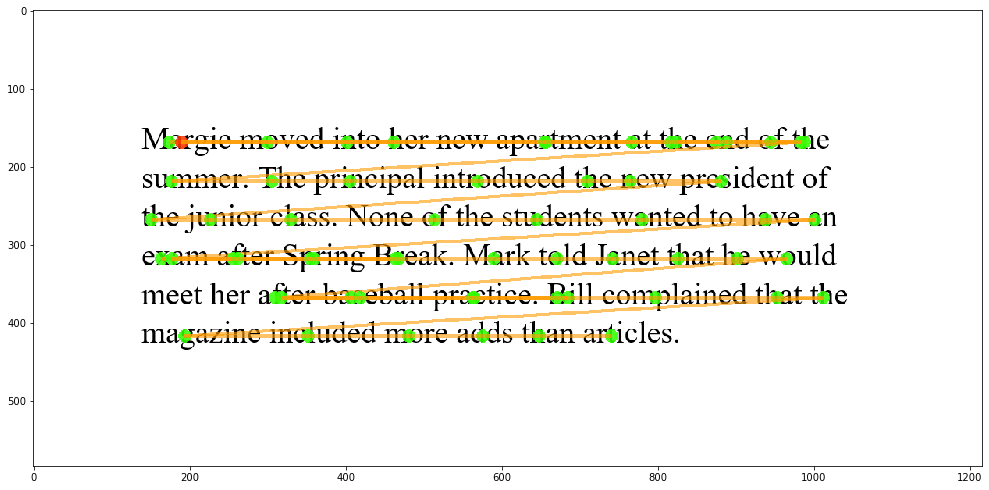

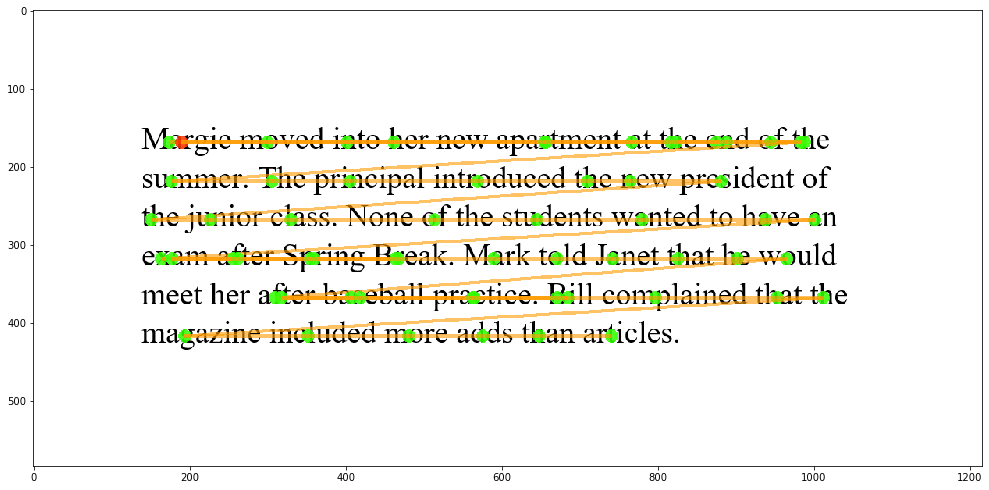

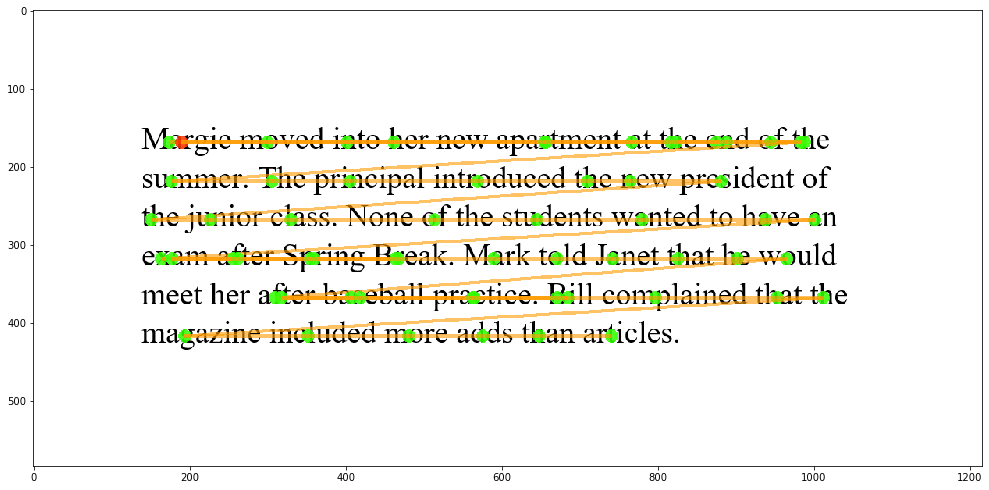

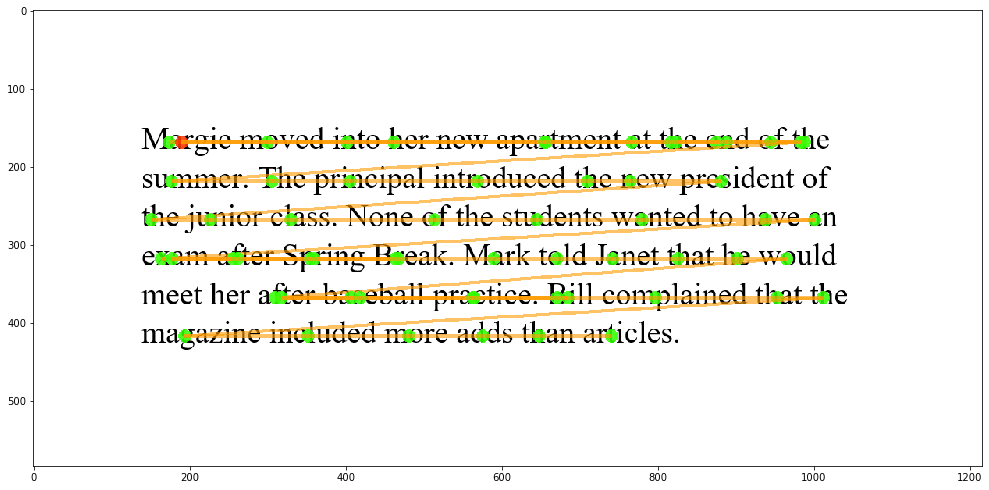

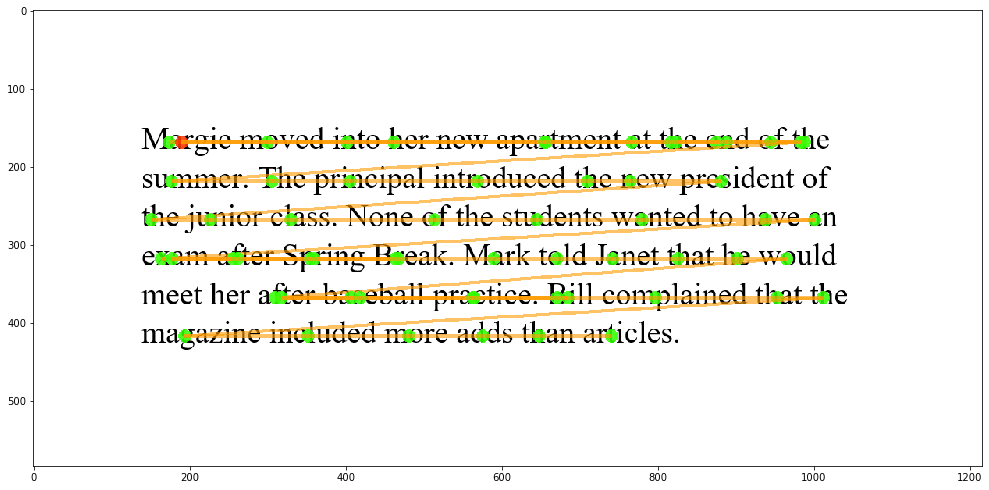

...

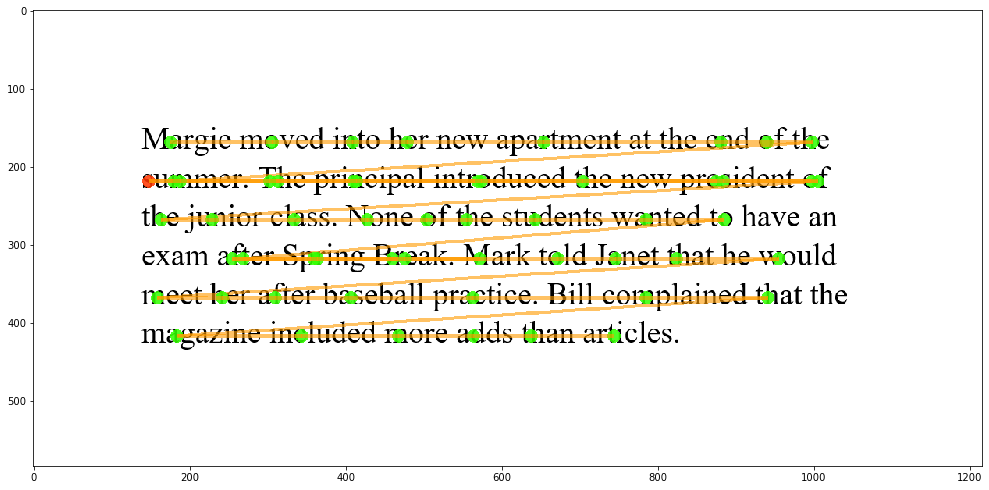

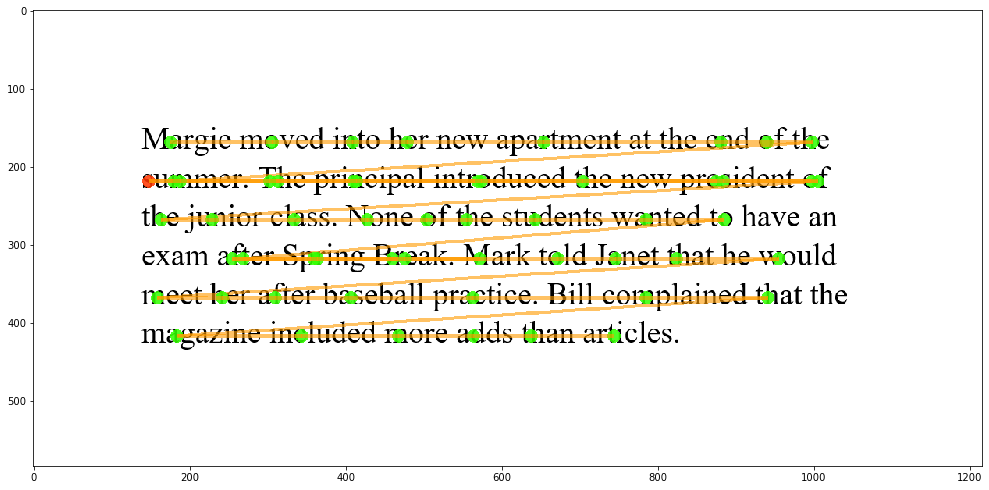

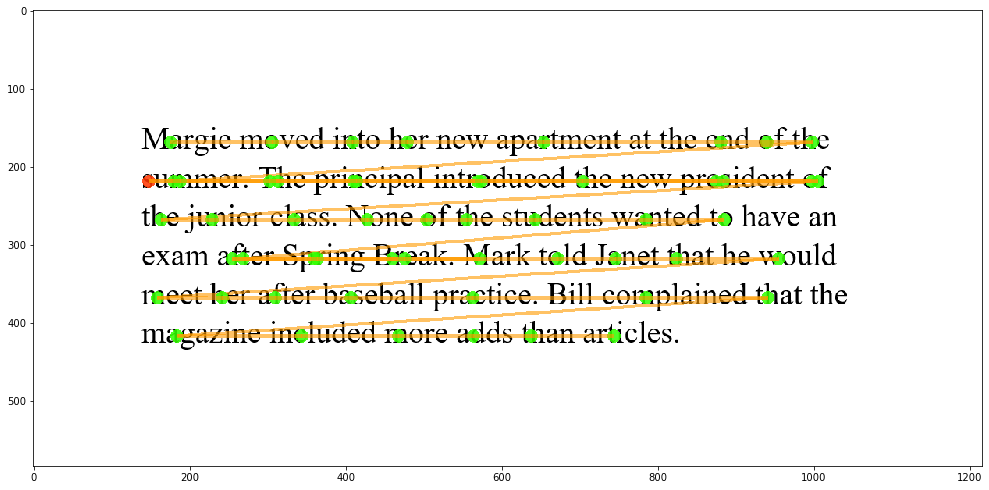

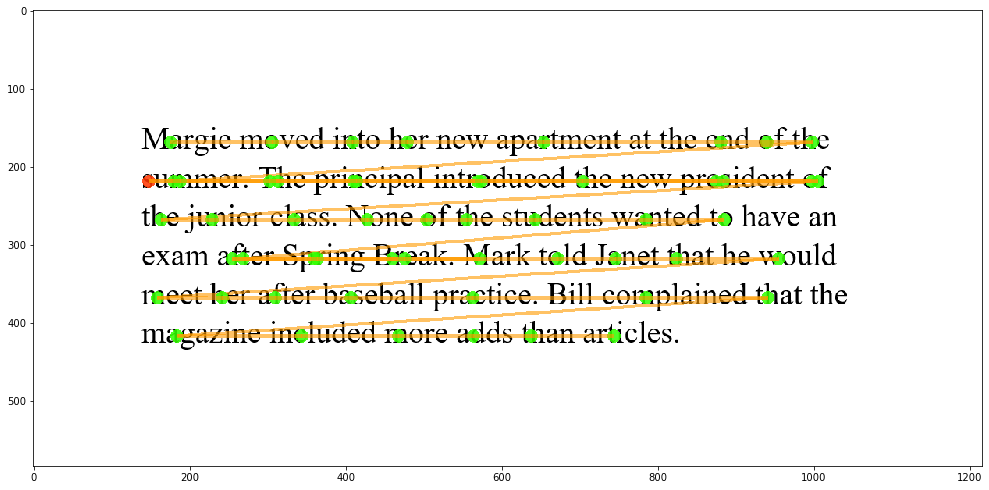

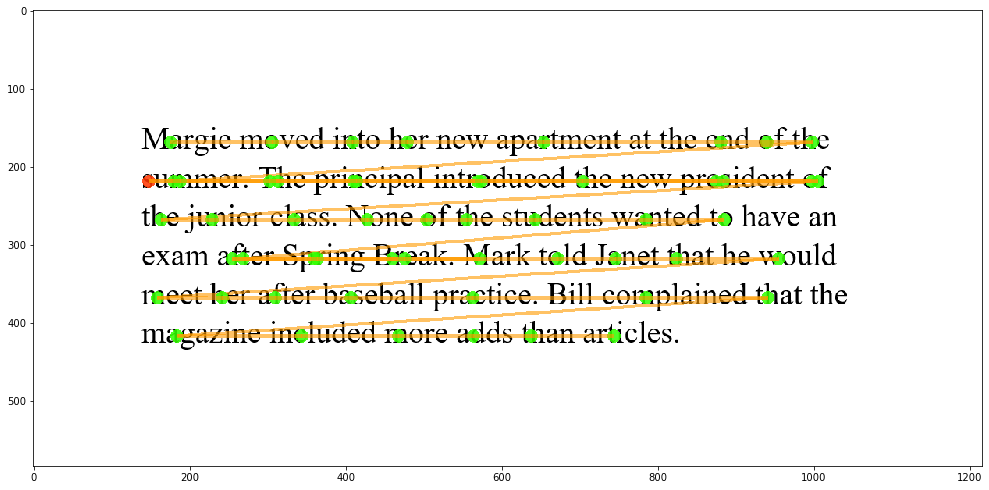

In [7]:
attach_results = [[],[],[],[],[],[],[],[],[],[],[]]
chain_results = [[],[],[],[],[],[],[],[],[],[],[]]
cluster_results = [[],[],[],[],[],[],[],[],[],[],[]]
compare_results = [[],[],[],[],[],[],[],[],[],[],[]]
regress_results = [[],[],[],[],[],[],[],[],[],[],[]]
merge_results = [[],[],[],[],[],[],[],[],[],[],[]]
split_results = [[],[],[],[],[],[],[],[],[],[],[]]
segment_results = [[],[],[],[],[],[],[],[],[],[],[]]
stretch_results = [[],[],[],[],[],[],[],[],[],[],[]]
warp_results = [[],[],[],[],[],[],[],[],[],[],[]]

word_centers = correction.find_word_centers(aoi)
word_centers = np.array(word_centers.copy(), dtype=int)

duration_word_centers = correction.find_word_centers_and_duration(aois_with_tokens)
duration_word_centers = np.array(duration_word_centers.copy(), dtype=int)

# MAKE SURE YOU RUN THIS 100 TIMES, NOT JUST ONE!!!
for robot_index in tqdm(range(100)):
    
    for error_probability in range(0, 11):
        # generate error
        error_test = correction.error_noise(error_probability/10, 30, error_probability/10, data['robot' + str(robot_index)].copy())

        # attach correction
        np_array = np.array(error_test.copy())
        attach_correction = algo.attach(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), attach_correction)
        attach_results[error_probability].append(percentage)

        # chain correction
        np_array = np.array(error_test.copy())
        chain_correction = algo.chain(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), chain_correction)
        chain_results[error_probability].append(percentage)
        
        # cluster correction
        np_array = np.array(error_test.copy())
        cluster_correction = algo.cluster(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), cluster_correction)
        cluster_results[error_probability].append(percentage)

        # compare correction
        np_array = np.array(error_test.copy())
        compare_correction = algo.compare(np_array, word_centers)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), compare_correction)
        compare_results[error_probability].append(percentage)

        # merge correction
        np_array = np.array(error_test.copy())
        merge_correction = algo.merge(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), merge_correction)
        merge_results[error_probability].append(percentage)
        
        # regress correction
        np_array = np.array(error_test.copy())
        regress_correction = algo.regress(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), regress_correction)
        regress_results[error_probability].append(percentage)

        # segment correction
        np_array = np.array(error_test.copy())
        segment_correction = algo.segment(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), segment_correction)
        segment_results[error_probability].append(percentage)

        # split correction
        np_array = np.array(error_test.copy())
        split_correction = algo.split(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), split_correction)
        split_results[error_probability].append(percentage)

        # strecth correction
        np_array = np.array(error_test.copy())
        stretch_correction = algo.stretch(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), stretch_correction)
        stretch_results[error_probability].append(percentage)
        
        # warp correction
        np_array = np.array(error_test.copy(), dtype=int)
        durations = np.delete(np_array, 0, 1)
        durations = np.delete(durations, 0, 1)
        np_array = np.delete(np_array, 2, 1)
        
        warp_correction = algo.warp(np_array, word_centers)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), warp_correction)
        warp_results[error_probability].append(percentage)

        if percentage < 1:
            correction.draw_correction('synthetic_text.png', warp_correction, match_list)
            print("robot:", robot_index, "    error probability:", error_probability)


In [11]:
import statistics

def mean_error_group(results):
    new_list = []
    
    for result in results:
        new_list.append(statistics.mean(result))
        
    return new_list

In [12]:
mean_attach_results = mean_error_group(attach_results)
mean_chain_results = mean_error_group(chain_results)
mean_regress_results = mean_error_group(regress_results)
mean_warp_results = mean_error_group(warp_results)
mean_cluster_results = mean_error_group(cluster_results)
mean_compare_results = mean_error_group(compare_results)
mean_merge_results = mean_error_group(merge_results)
mean_split_results = mean_error_group(split_results)
mean_segment_results = mean_error_group(segment_results)
mean_stretch_results = mean_error_group(stretch_results)

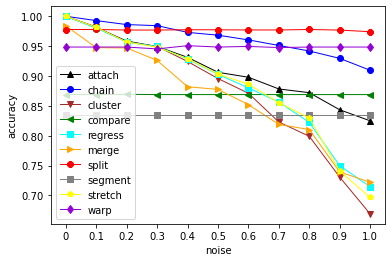

In [13]:
import matplotlib.pyplot as plt
plt.plot(mean_attach_results, color='Black', linewidth=1, marker='^')
plt.plot(mean_chain_results, color='Blue', linewidth=1, marker='o')
plt.plot(mean_cluster_results, color='Brown', linewidth=1, marker='v')
plt.plot(mean_compare_results, color='Green', linewidth=1, marker='<')
plt.plot(mean_regress_results, color='Aqua', linewidth=1, marker='s')
plt.plot(mean_merge_results, color='Orange', linewidth=1, marker='>')
plt.plot(mean_split_results, color='Red', linewidth=1, marker='8')
plt.plot(mean_segment_results, color='Grey', linewidth=1, marker='s')
plt.plot(mean_stretch_results, color='Yellow', linewidth=1, marker='p')
plt.plot(mean_warp_results, color='DarkViolet', linewidth=1, marker='d')

plt.legend(['attach', 'chain', 'cluster','compare', 'regress', 'merge', 'split', 'segment', 'stretch', 'warp'])
plt.ylabel('accuracy')
plt.xlabel('noise')

x_ticks_labels = ['0', '0.1', '0.2', '0.3', '0.4', '0.5', '0.6', '0.7', '0.8', '0.9', '1.0']
plt.xticks(range(0, 11), x_ticks_labels)
#plt.savefig("noise_comparison.png")
plt.show()

In [15]:
print("mean attach:", statistics.mean(mean_attach_results))
print("mean chain:", statistics.mean(mean_chain_results))
print("mean cluster:", statistics.mean(mean_cluster_results))
print("mean compare:", statistics.mean(mean_compare_results))
print("mean regress:", statistics.mean(mean_regress_results))
print("mean cluster:", statistics.mean(mean_cluster_results))
print("mean compare:", statistics.mean(mean_compare_results))
print("mean warp:", statistics.mean(mean_warp_results))

mean attach: 0.912943098883734
mean chain: 0.9633143667096166
mean cluster: 0.8727725395136737
mean compare: 0.8688623586463723
mean regress: 0.8854392913986253
mean cluster: 0.8727725395136737
mean compare: 0.8688623586463723
mean warp: 0.9483658610581708
